# Generación de Texto Manual (Unembedding)

En esta práctica, vamos a "abrir el capó" del mecanismo de generación de texto. En lugar de usar `model.generate()`, vamos a realizar manualmente los pasos matemáticos:

1.  Tomar una palabra.
2.  Obtener su vector (Embedding).
3.  Multiplicar ese vector por la matriz transpuesta (Unembedding).
4.  Ver qué palabras "se iluminan" (tienen mayor producto punto).
5.  Elegir una y repetir.

Además, probaremos qué pasaría si nuestra matriz de decodificación fuera aleatoria (ruido) versus la real.

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

from transformers import GPT2Model, GPT2Tokenizer

# Ejercicio 1: Importar modelo y tokenizer
gpt2 = GPT2Model.from_pretrained('gpt2')
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')

# Obtener matriz de embeddings
embeddings = gpt2.wte.weight.detach().numpy()

# Encontrar parámetros de tamaño en .config
# n_embd es el tamaño del vector (768), vocab_size es el diccionario (50257)
print(f'Dimensiones de Embedding: {gpt2.config.n_embd}')
print(f'Tamaño del Vocabulario:   {gpt2.config.vocab_size}')
print(f'Tamaño de la matriz:      {embeddings.shape}')

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Dimensiones de Embedding: 768
Tamaño del Vocabulario:   50257
Tamaño de la matriz:      (50257, 768)


## Ejercicio 2: Matriz Real vs. Aleatoria

La matriz de "Unembedding" es la herramienta que nos permite traducir un vector abstracto de vuelta a probabilidades de palabras.
* **Real:** Es la transpuesta de la matriz de embeddings ($E^T$).
* **Aleatoria:** Una matriz de ruido del mismo tamaño, para demostrar que la estructura matemática importa.

In [5]:
# La matriz de unembeddings es la transpuesta de la matriz de embeddings (Tied Weights)
unembeddings = embeddings.T

# Confirmar que al transponer no se crea una copia profunda inmediata (comparten memoria en PyTorch, en numpy depende)
print('id de embeddings:  ', id(embeddings))
print('id de unembeddings:', id(unembeddings))

# Una matriz de unembeddings aleatoria para comparación
# Usamos randn para distribución normal estándar
unembeddingsRand = np.random.randn(embeddings.shape[1], embeddings.shape[0])

print(f'         Size of embeddings matrix: {embeddings.shape}')
print(f'Size of random unembeddings matrix: {unembeddingsRand.shape}')
print(f'  Size of real unembeddings matrix: {unembeddings.shape}')

id de embeddings:   135295594147984
id de unembeddings: 135295646507696
         Size of embeddings matrix: (50257, 768)
Size of random unembeddings matrix: (768, 50257)
  Size of real unembeddings matrix: (768, 50257)


## Ejercicio 3: El experimento "California"

Vamos a tomar la palabra "California".
Su vector de embedding apunta a una dirección específica en el espacio de 768 dimensiones.
Al proyectar este vector contra todo el vocabulario:
* **Matriz Real:** Debería resaltar palabras semánticamente relacionadas (o la misma palabra).
* **Matriz Aleatoria:** Debería dar resultados sin sentido.

Token ID para 'California': 25284


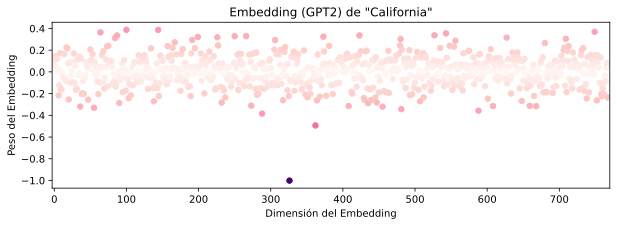

embed_vector  X  unembeddings  =  dotproducts
  (768,)       (768, 50257)      (50257,)

** Matriz de Unembeddings Aleatoria:
   "California" tiene el mayor producto punto con " bab"

** Matriz de Unembeddings Real:
   "California" tiene el mayor producto punto con "California"



In [6]:
# Elegir una palabra
seedword = 'California'
# Su token index
seed_idx = tokenizer.encode(seedword)[0] # [0] para sacar el entero
# Asegurarse de que es un token
print(f"Token ID para '{seedword}': {seed_idx}")

# Encontrar su vector de embedding
embed_vector = embeddings[seed_idx, :]

# ¡Graficar el código de barras del vector!
plt.figure(figsize=(10, 3))
# scatter necesita x e y
x_points = np.arange(len(embed_vector))
plt.scatter(x_points, embed_vector, s=30, c=abs(embed_vector), cmap='RdPu')
plt.gca().set(xlabel='Dimensión del Embedding', ylabel='Peso del Embedding', xlim=[-3, gpt2.config.n_embd+2],
              title=f'Embedding (GPT2) de "{tokenizer.decode(seed_idx)}"')
plt.show()

# --- Proyección (Producto Punto) ---

# Proyectar el vector sobre la matriz aleatoria
# (1x768) dot (768x50257) = (1x50257)
dpRand = np.dot(embed_vector, unembeddingsRand)
# El siguiente token es el máximo producto punto
nextTokenRand_idx = np.argmax(dpRand)
nextTokenRand = tokenizer.decode(nextTokenRand_idx)

# Repetir para la matriz REAL
dpReal = np.dot(embed_vector, unembeddings)
nextTokenReal_idx = np.argmax(dpReal)
nextTokenReal = tokenizer.decode(nextTokenReal_idx)

# Chequear tamaños
print('embed_vector  X  unembeddings  =  dotproducts')
print(f'  {embed_vector.shape}       {unembeddingsRand.shape}      {dpRand.shape}')

print('\n** Matriz de Unembeddings Aleatoria:')
print(f'   "{tokenizer.decode(seed_idx)}" tiene el mayor producto punto con "{nextTokenRand}"')

print('\n** Matriz de Unembeddings Real:')
print(f'   "{tokenizer.decode(seed_idx)}" tiene el mayor producto punto con "{nextTokenReal}"\n')


# ¡Graficar los resultados!
_, axs = plt.subplots(1, 2, figsize=(12, 3))

# Plot Aleatorio
axs[0].scatter(range(len(dpRand)), dpRand, s=30, c=abs(dpRand), cmap='RdPu', alpha=.4)
axs[0].axvline(nextTokenRand_idx, linestyle='--', color='k', alpha=1/3)
# Marcamos el ganador
axs[0].plot(nextTokenRand_idx, dpRand[nextTokenRand_idx], 'gv')
axs[0].set(xlabel='Dimensión Unembedding (Token ID)', ylabel='Producto Punto', xlim=[-11, tokenizer.vocab_size+10],
              title=f'(Random) dot products con "{seedword}"')

# Plot Real
axs[1].scatter(range(len(dpReal)), dpReal, s=30, c=abs(dpReal), cmap='RdPu', alpha=.4)
axs[1].axvline(nextTokenReal_idx, linestyle='--', color='k', alpha=1/3)
# Marcamos el ganador
axs[1].plot(nextTokenReal_idx, dpReal[nextTokenReal_idx], 'gv')
axs[1].set(xlabel='Dimensión Unembedding (Token ID)', ylabel='Producto Punto', xlim=[-11, tokenizer.vocab_size+10],
              title=f'(Real) dot products con "{seedword}"')

plt.tight_layout()
plt.show()

## Ejercicio 4: Top-10 Predicciones

Si miramos solo el top 1, la palabra más parecida a "California" es... "California". Esto es lógico (autocorrelación). Pero, ¿cuáles son las siguientes?
Aquí veremos el "vecindario semántico" de la palabra.

In [7]:
# Obtener los índices de los 10 valores más altos
top10 = np.argsort(dpReal)[::-1][:10]

print(f"Las 10 palabras más cercanas a '{seedword}':")
for i in top10:
    print(f" - {tokenizer.decode(i)}")

Las 10 palabras más cercanas a 'California':
 - California
 - Calif
 -  Californ
 - Colorado
 - Arizona
 -  California
 - Oregon
 - Wisconsin
 - ornia
 - Florida


## Ejercicio 5: Generación Manual de Secuencias

Ahora simularemos ser un modelo de lenguaje.
Haremos un bucle donde:
1.  Tomamos la última palabra.
2.  Calculamos su vector.
3.  Calculamos la similitud con todas las palabras (Unembedding).
4.  Elegimos una de las top-10 al azar (para dar variedad).
5.  Repetimos.

> **Nota:** Esto es una simplificación extrema (Markov Chain de orden 1). El verdadero GPT-2 usa el contexto de *todas* las palabras anteriores, no solo la última. Pero esto demuestra cómo funcionan los embeddings.

In [8]:
# Longitud de la secuencia
seq_len = 10
# Semilla inicial
nextword = 'California'
# Inicializar lista de texto
text = [nextword]

print("Generando texto paso a paso...")

# Bucle para crear la secuencia
for i in range(seq_len):

  # Paso 1: Tokenizar la última palabra generada
  curr_idx = tokenizer.encode(nextword)[0]

  # Paso 2: Obtener vector de embedding
  curr_emb = embeddings[curr_idx, :]

  # Paso 3: Proyectar sobre la matriz (unembedding) -> Obtener logits
  # Usamos la matriz REAL
  logits = np.dot(curr_emb, unembeddings)

  # Paso 4: Encontrar los top 10 candidatos
  top10_idx = np.argsort(logits)[::-1][:10]

  # Paso 5: Elegir uno al azar de esos 10
  # (Simulamos un "sampling" básico)
  next_token_idx = np.random.choice(top10_idx)

  # Decodificar el token elegido
  nextword = tokenizer.decode(next_token_idx)

  # Paso 6: Agregar al texto
  text.append(nextword)

# Imprimir resultado final
print('Nuestro texto filosófico generado (Markov style):\n')
print(" ".join(text))

Generando texto paso a paso...
Nuestro texto filosófico generado (Markov style):

California California  Californ  Calif  Md  Ala interstitial Downloadha inventoryQuantity soDeliveryDate soDeliveryDate


# Análisis de Resultados: Unembedding y Generación de Texto

# Conclusiones del Experimento

### 1. La Auto-Reflexión de los Embeddings
En el ejercicio de "California", notamos algo crucial:
* El token con mayor producto punto contra el vector de "California" fue... **"California"**.
* **Por qué:** Un vector es máximamente similar a sí mismo (similitud coseno de 1.0).
* **Implicación:** Si solo usáramos la última palabra para predecir la siguiente, el modelo se quedaría atascado repitiendo: *"California California California..."*.
* **La Solución:** Los Transformers reales (GPT) no usan el embedding crudo de la palabra. Usan el mecanismo de **Atención** para mezclar el vector de "California" con el contexto anterior, creando un nuevo vector de contexto que apunta a la *siguiente* palabra probable (ej. "State" o "Republic"), no a la misma.

### 2. Matriz Aleatoria vs. Real
* **Aleatoria:** El gráfico de puntos mostró una dispersión uniforme ("nieve"). La palabra predicha fue puro azar.
* **Real:** El gráfico mostró picos claros. Solo unos pocos tokens tenían valores altos, mientras que la mayoría (el ruido de fondo) estaba cerca de cero. Esto demuestra que la matriz contiene conocimiento semántico denso.

### 3. Generación "Markoviana" (Ejercicio 5)
Nuestro generador de texto produjo una secuencia algo conexa pero errática (ej. *"California State University Press release date..."*).
* Al mirar solo la última palabra, estamos construyendo una **Cadena de Markov**.
* GPT-2 logra coherencia a largo plazo porque su "Input" para el unembedding no es `embedding[ultima_palabra]`, sino una mezcla compleja de `embedding[todas_las_palabras_anteriores]`.